In [1]:
import re
import os
import STAVAG
import numpy as np
import pandas as pd
import scanpy as sc
import matplotlib.pyplot as plt
from matplotlib.colors import LinearSegmentedColormap
from scipy.cluster.hierarchy import dendrogram, linkage, fcluster

# Suppress warnings
import warnings
warnings.filterwarnings("ignore")

C:\Users\Administrator\AppData\Roaming\Python\Python39\site-packages\pandas\core\computation\expressions.py:21: UserWarning: Pandas requires version '2.8.4' or newer of 'numexpr' (version '2.8.1' currently installed).
  from pandas.core.computation.check import NUMEXPR_INSTALLED
C:\Users\Administrator\AppData\Roaming\Python\Python39\site-packages\pandas\core\arrays\masked.py:60: UserWarning: Pandas requires version '1.3.6' or newer of 'bottleneck' (version '1.3.4' currently installed).
  from pandas.core import (


## Data loading

Data can be downloaded from https://db.cngb.org/stomics/mosta/download/.

In [2]:
# Specify main directory path
main_dir = r'E:\Fast_SVG\Data\steroeseq_MOSTA'

# Initialize list to store all AnnData objects
adata_list = []

# Iterate through folders and process each .h5ad file
for folder in sorted(os.listdir(main_dir)):
    folder_path = os.path.join(main_dir, folder)
    if os.path.isdir(folder_path):
        # Find .h5ad file
        h5ad_file = [f for f in os.listdir(folder_path) if f.endswith('.MOSTA.h5ad')]
        if h5ad_file:
            file_path = os.path.join(folder_path, h5ad_file[0])
            adata1 = sc.read_h5ad(file_path)
            
            # Extract time information (first two characters before '_' as time value)
            time_value = folder.split('_')[0].replace('E', '')
            
            # Add time column to obs
            adata1.obs['time'] = float(time_value)
            
            # Get spatial coordinates
            spatial_coords = adata1.obsm['spatial']
            
            # Rotate coordinates 180° clockwise by negation
            rotated_coords = -spatial_coords
            
            # Assign rotated coordinates back to adata
            adata1.obsm['spatial'] = rotated_coords
            
            # Additional flip on X-axis for correction
            adata1.obsm['spatial'][:, 0] = -1 * adata1.obsm['spatial'][:, 0]
            # Add processed AnnData to list
            adata_list.append(adata1)

# Concatenate all AnnData objects
adata = adata_list[0].concatenate(*adata_list[1:])
# [optional] You can convert adata.x to array to speed up STAVAG, but will increase the cost of memory.
#adata.x = adata.x.to_array()

In [3]:
# Adjust the Angle of the visualization
time_9_5_cells = adata.obs['time'] == 9.5
adata.obsm['spatial'][time_9_5_cells, 0] -= 420

theta = 30 * np.pi / 180 
rotation_matrix = np.array([[np.cos(theta), np.sin(theta)],
                            [-np.sin(theta), np.cos(theta)]])
spatial_coords = adata.obsm['spatial'][time_9_5_cells, :] 
rotated_coords = spatial_coords.dot(rotation_matrix.T)
adata.obsm['spatial'][time_9_5_cells, :] = rotated_coords

adata.obsm['spatial'][time_9_5_cells, 0] -= 320
adata.obsm['spatial'][time_9_5_cells, 1] -= 100

time_10_5_cells = adata.obs['time'] == 10.5
adata.obsm['spatial'][time_10_5_cells, 0] -= 160

time_11_5_cells = adata.obs['time'] == 11.5
adata.obsm['spatial'][time_11_5_cells, 1] += 520
adata.obsm['spatial'][time_11_5_cells, 0] -= 20

time_12_5_cells = adata.obs['time'] == 12.5
adata.obsm['spatial'][time_12_5_cells, 1] += 540
adata.obsm['spatial'][time_12_5_cells, 0] += 140

time_13_5_cells = adata.obs['time'] == 13.5
adata.obsm['spatial'][time_13_5_cells, 1] += 500
adata.obsm['spatial'][time_13_5_cells, 0] += 90

time_14_5_cells = adata.obs['time'] == 14.5
adata.obsm['spatial'][time_14_5_cells, 1] -= 200
adata.obsm['spatial'][time_14_5_cells, 0] += 390

time_15_5_cells = adata.obs['time'] == 15.5
adata.obsm['spatial'][time_15_5_cells, 1] += 500
adata.obsm['spatial'][time_15_5_cells, 0] += 1170

time_16_5_cells = adata.obs['time'] == 16.5
adata.obsm['spatial'][time_16_5_cells, 1] += -190
adata.obsm['spatial'][time_16_5_cells, 0] += 1200

In [4]:
sc.pp.filter_genes(adata, min_cells=10)#之前这里是否注释掉了
sc.pp.normalize_total(adata, target_sum=1e4)
sc.pp.log1p(adata)

# Visualize the data

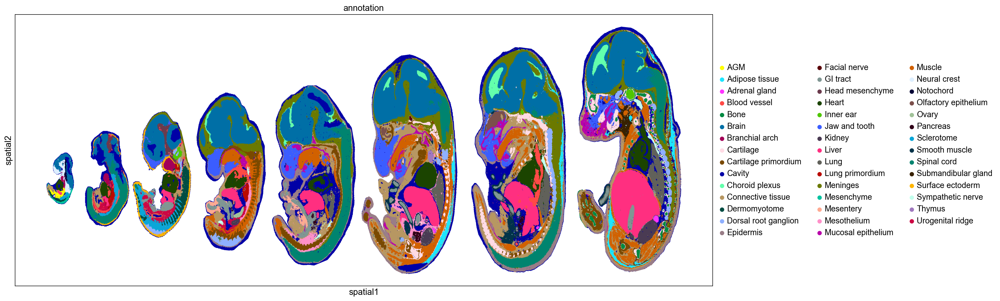

In [5]:
sc.set_figure_params(figsize=(20,8))
sc.pl.embedding(adata, basis='spatial', color='annotation', size=5)

## Detect TVGs

coords should be the temporal, i.e. one-dimensional data.

In [6]:
coords = np.array(adata.obs['time']).reshape(-1,1)
coord_dict = STAVAG.TVG_detection(adata, coords)
TVGs = list(coord_dict['T']['Feature'])

## Gene modules detection

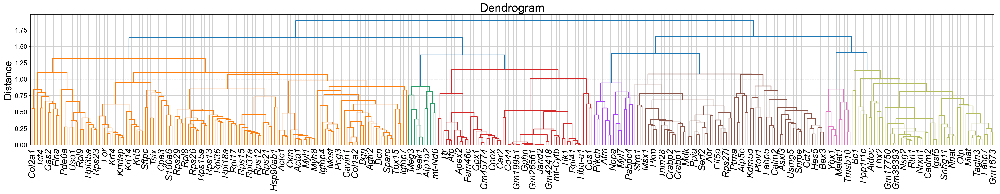

In [7]:
Z, corr, df = STAVAG.gene_modules(adata, TVGs)
plt.figure(figsize=(30, 6))
ax = plt.gca()
labels = ax.get_xticklabels()
dendro = dendrogram(Z, labels=corr.columns, leaf_rotation=45)
ax = plt.gca()
labels = ax.get_xticklabels()

for i, label in enumerate(labels):
    if i % 3 != 0: 
        label.set_visible(False)
plt.axhline(y=1, color='gray', linestyle='--', linewidth=1)
plt.title("Dendrogram", fontsize=25)
plt.ylabel("Distance", fontsize=22)
plt.xticks(fontsize=20, fontstyle='italic', rotation=90)
plt.tight_layout()
plt.show()

In [8]:
max_clusters = 17# Tune this parameter to control the fine granularity of clustering.
clusters = fcluster(Z, max_clusters, criterion='maxclust')

In [9]:
sc.set_figure_params(figsize=(10,4))

Module 1 . Number of genes: 11


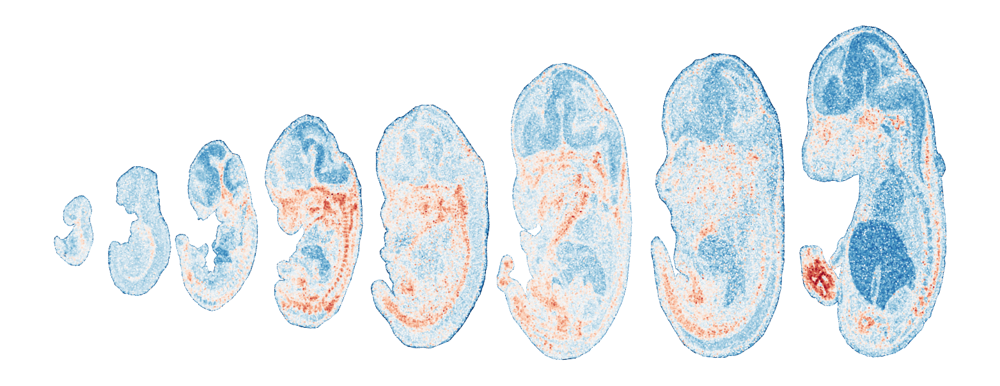

Module 2 . Number of genes: 14


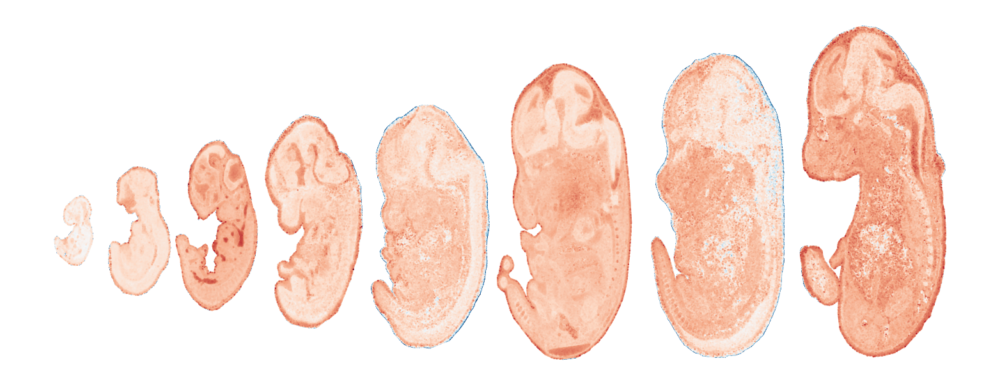

Module 3 . Number of genes: 28


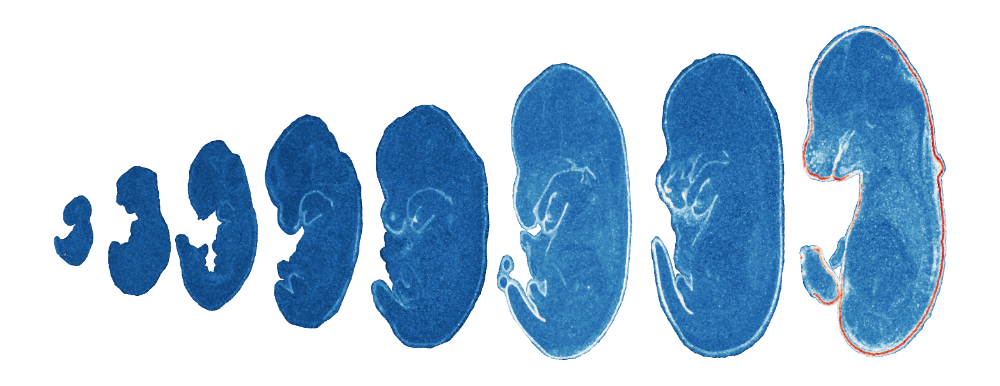

Module 4 . Number of genes: 39


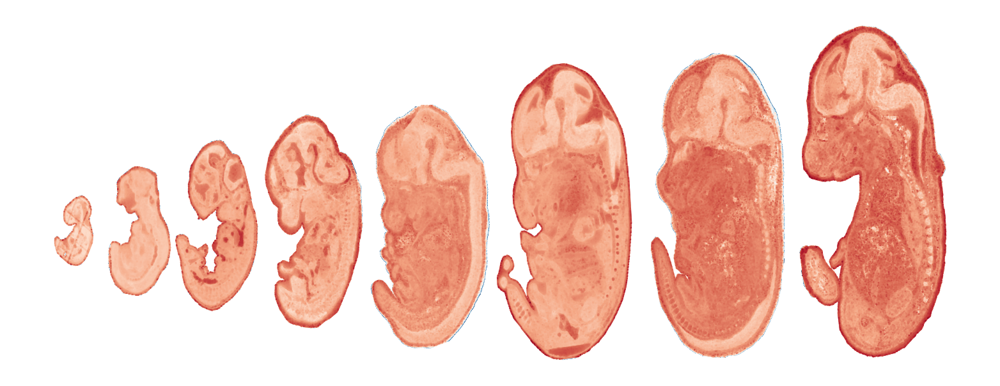

Module 5 . Number of genes: 48


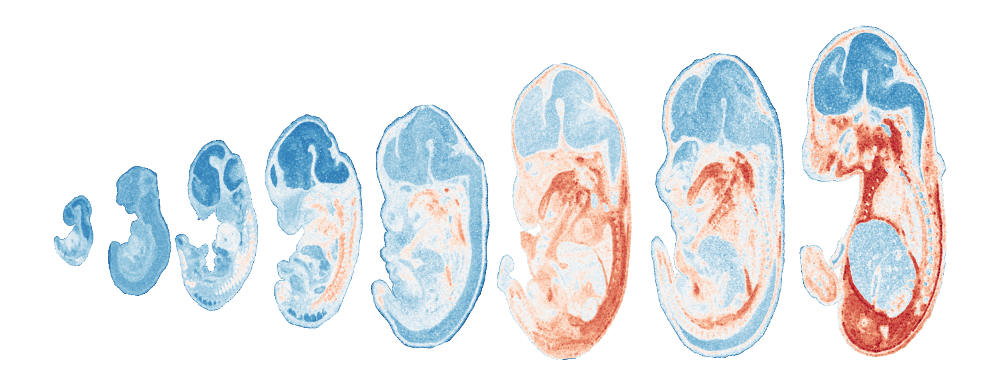

Module 6 . Number of genes: 11


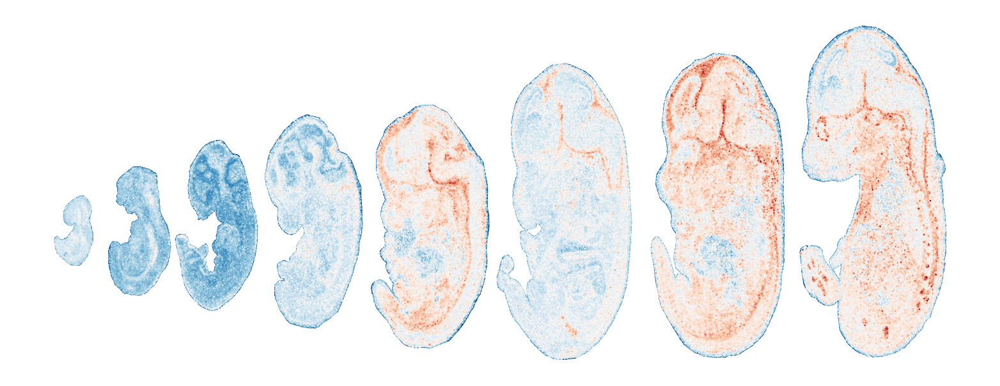

Module 7 . Number of genes: 24


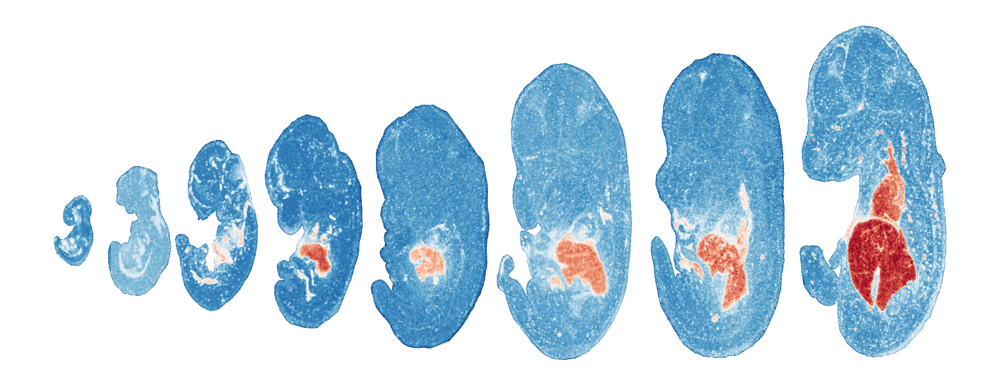

Module 8 . Number of genes: 30


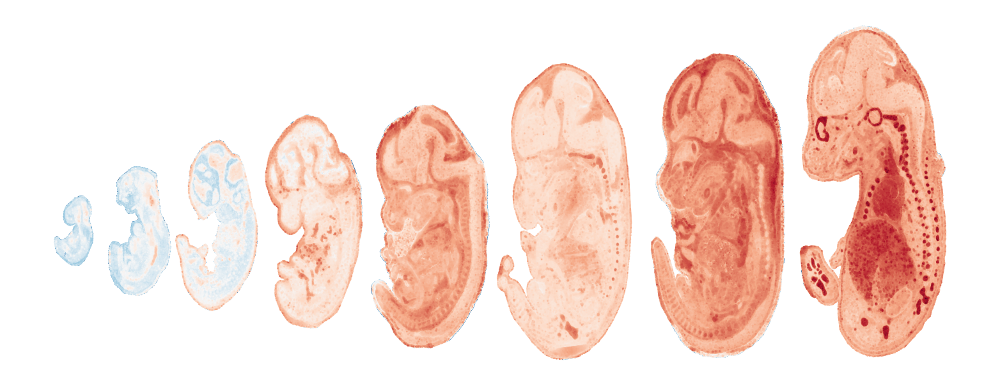

Module 9 . Number of genes: 4


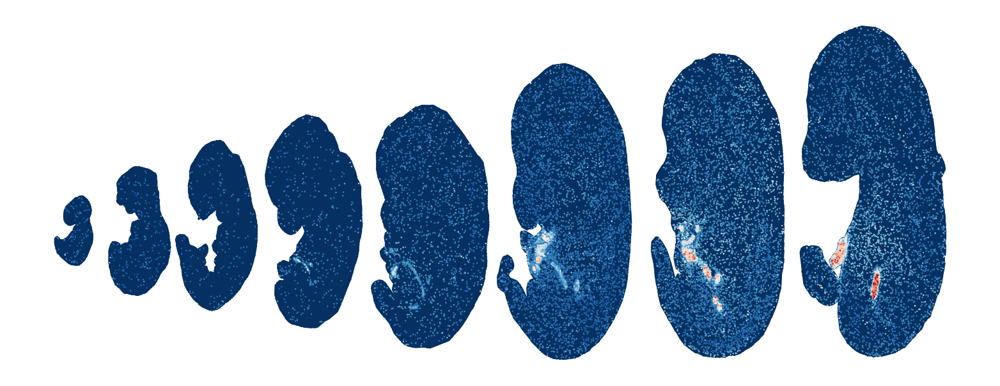

Module 10 . Number of genes: 15


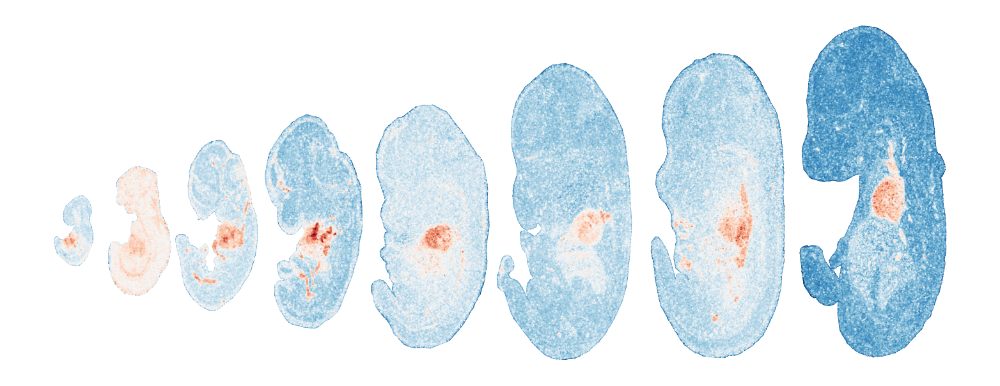

Module 11 . Number of genes: 37


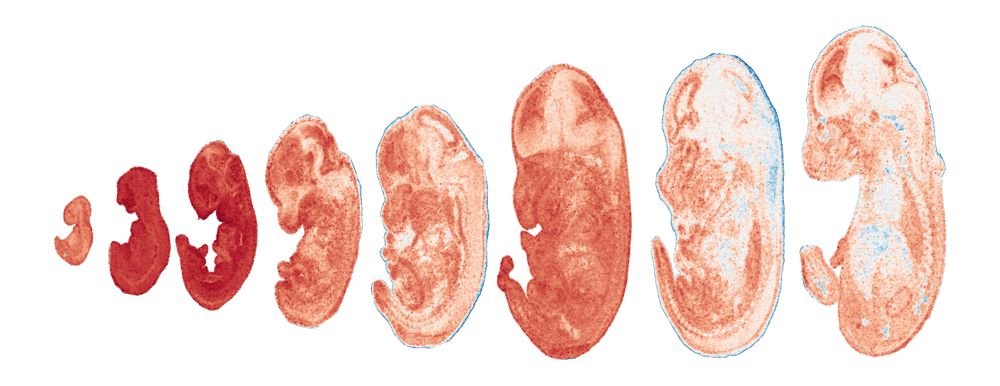

Module 12 . Number of genes: 6


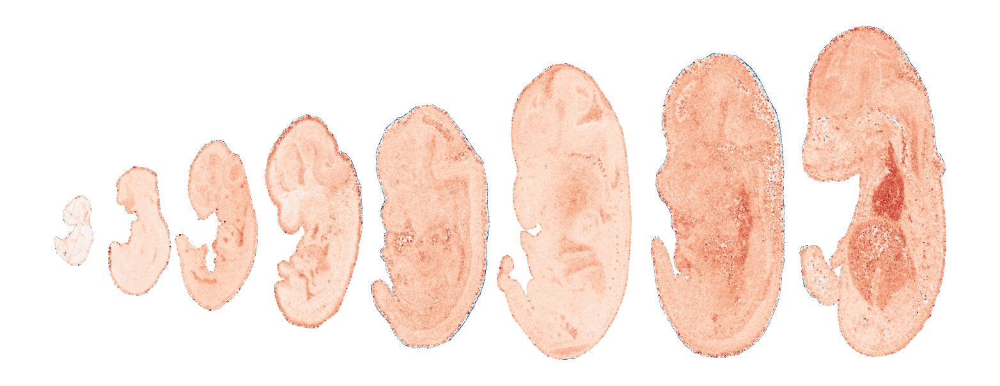

Module 13 . Number of genes: 28


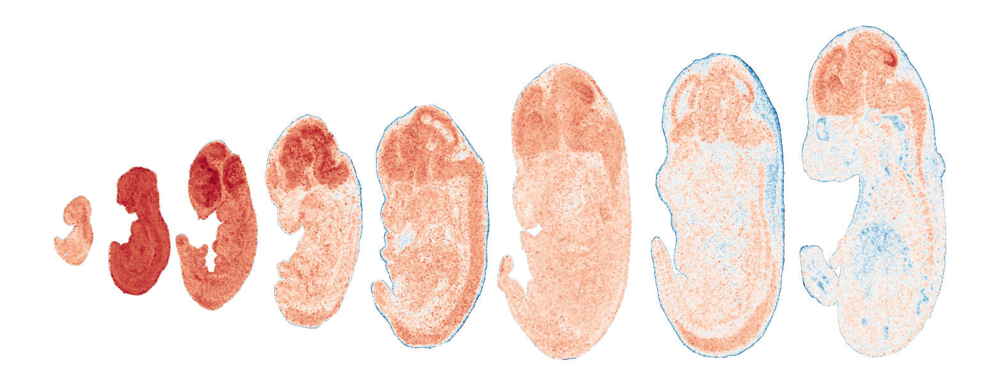

Module 14 . Number of genes: 10


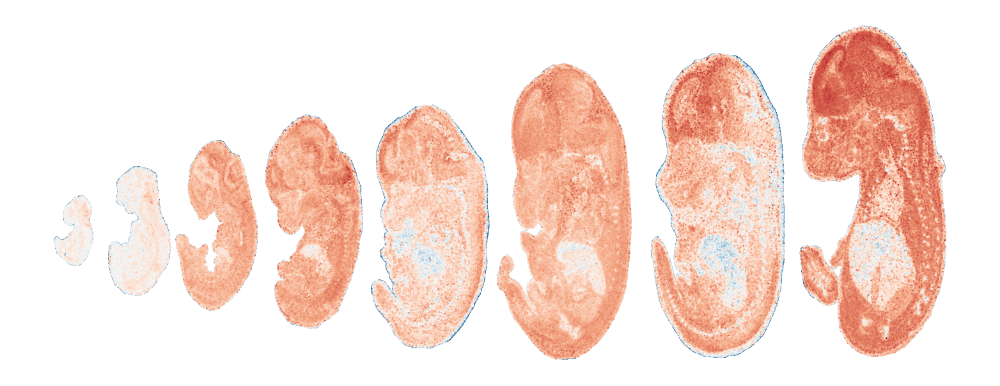

Module 15 . Number of genes: 2


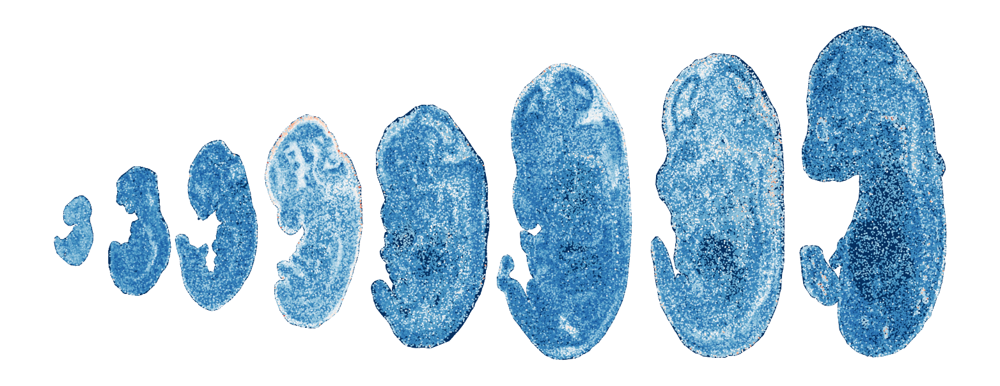

Module 16 . Number of genes: 4


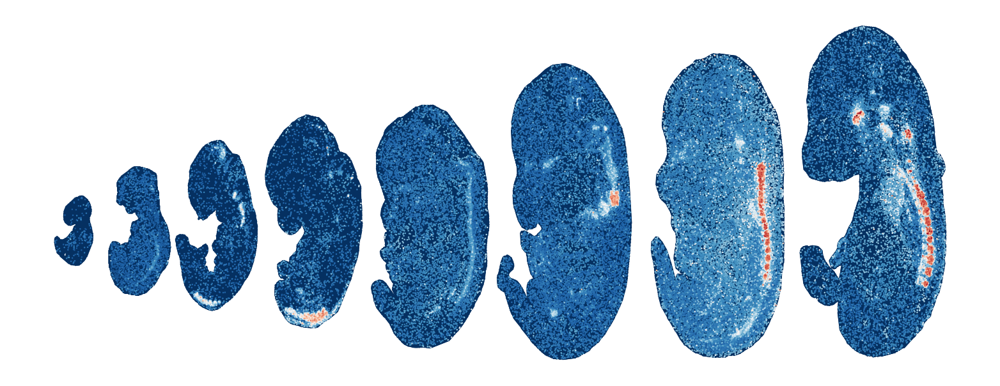

Module 17 . Number of genes: 47


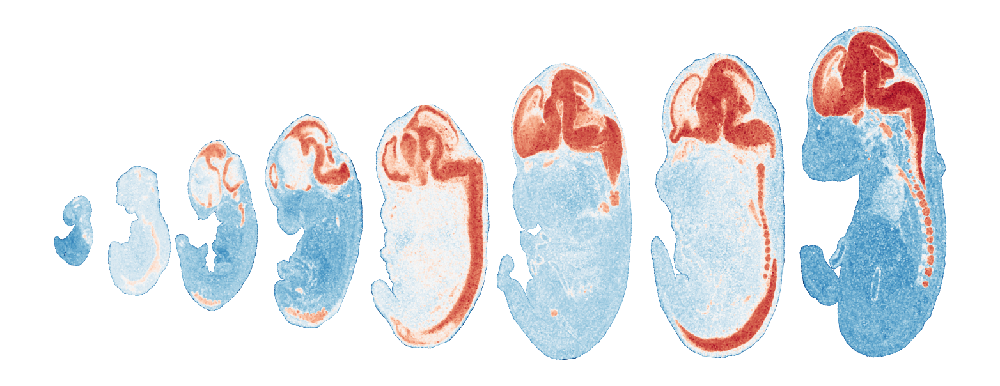

In [10]:
# Map clustering results to corresponding column names
cluster_labels = {name: cluster for name, cluster in zip(corr.columns, clusters)}

# Create an empty DataFrame for each cluster to store corresponding columns
cluster_groups = {i: pd.DataFrame() for i in np.unique(clusters)}

# Assign each column to its corresponding cluster DataFrame
for col in df.columns:
    cluster = cluster_labels[col]
    cluster_groups[cluster][col] = df[col]

# Calculate the average value across columns for each cluster
count = 1
for cluster, data in cluster_groups.items():
    mean_values = data.mean(axis=1)
    print('Module', count, '. Number of genes:',data.shape[1])

    # Normalize to the range 0–1
    min_value = mean_values.min()
    max_value = mean_values.max()
    normalized_mean_values = (mean_values - min_value) / (max_value - min_value)

    adata.obs[str(count)] = normalized_mean_values
    sc.pl.embedding(
        adata,
        basis='spatial',
        color=str(count),
        # ax=axes[idx],
        legend_loc=None,       # Remove legend
        show=False,
        cmap='RdBu_r',
        vmax=1,
        vmin=0,
        size=5,
        colorbar_loc=None,
        frameon=False
    )
    plt.title('')  # Clear title
    plt.tight_layout()
    # plt.savefig('module_' + str(count) + '.png', dpi=300)
    plt.show()
    count += 1

## Export TVGs and corresponding modules

In [11]:
gene_cluster = pd.DataFrame([TVGs,clusters]).T
gene_cluster.columns = ['gene', 'modules']
gene_cluster.head()
#gene_cluster.to_csv('xxxxx.csv')

,gene,modules
0,Hbb-bh1,13
1,Cdk8,8
2,Hbb-bs,8
3,Gm42418,8
4,Hbb-y,10
